<a href="https://colab.research.google.com/github/lFoxxxyl/Unet-segmentation/blob/main/UNET.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Импорт

In [ ]:
import tensorflow as tf
from google.colab import drive
from glob import glob
import os
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import keras.backend as K
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau, CSVLogger
%load_ext tensorboard

#Подключение к Гугл Диску и загрузка данных

In [ ]:
drive.mount('/content/drive')
!unzip -q /content/drive/MyDrive/data7.zip

Mounted at /content/drive


#Функции для обработки исходных изображений и создания набра данных

In [ ]:
def load_data(path, split=0.1):
    images = sorted(glob(os.path.join(path, "image/*")))
    masks = sorted(glob(os.path.join(path, "mask/*")))

    total_size = len(images)
    valid_size = int(split * total_size)
    test_size = int(split * total_size)

    train_x, valid_x = train_test_split(images, test_size=valid_size, random_state=42)
    train_y, valid_y = train_test_split(masks, test_size=valid_size, random_state=42)

    train_x, test_x = train_test_split(train_x, test_size=test_size, random_state=42)
    train_y, test_y = train_test_split(train_y, test_size=test_size, random_state=42)

    return (train_x, train_y), (valid_x, valid_y), (test_x, test_y)

In [ ]:
def read_image(path):
    x = cv2.imread(path, cv2.IMREAD_COLOR)
    x = cv2.resize(x, (512, 512))
    x = x/255.0
    return x

In [ ]:
def read_mask(path):
    x = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    x = cv2.resize(x, (512, 512))
    x = cv2.threshold(x, 128, 255, cv2.THRESH_BINARY)[1]
    x = x/255.0
    x = x.astype(np.uint8)
    x = np.expand_dims(x, axis=-1)
    return x

In [ ]:
def tf_parse(x, y):
    def _parse(x, y):
        x = read_image(x.decode())
        y = read_mask(y.decode())
        return x, y
    x, y = tf.numpy_function(_parse, [x, y], [tf.float64, tf.uint8])
    x.set_shape([512, 512, 3])
    y.set_shape([512, 512, 1])
    return x, y

In [ ]:
def tf_dataset(x, y, batch=8):
    dataset = tf.data.Dataset.from_tensor_slices((x, y))
    dataset = dataset.map(tf_parse)
    dataset = dataset.batch(batch)
    dataset = dataset.repeat()
    return dataset

#Вспомогательные функции

In [ ]:
def show_images(image, true_mask = None, predicted_mask = None, path = None):
    
    plt.figure(figsize=(20, 20))
    number = 1
    
    image = image*255
    image = image.astype(np.uint8)
    plt.subplot(1, 3, number)
    plt.title('Input Image')
    plt.imshow(tf.keras.preprocessing.image.array_to_img(image))
    plt.axis('off')
    number+=1

    if true_mask is not None:
        true_mask = true_mask*255
        true_mask = cv2.cvtColor(true_mask, cv2.COLOR_GRAY2RGB)
        true_mask[(true_mask == (255, 255, 255 )).all(axis=-1)] = (255, 0, 0)
        plt.subplot(1, 3, number)
        plt.title('True Mask')
        plt.imshow(tf.keras.preprocessing.image.array_to_img(cv2.add(image, true_mask)))
        plt.axis('off')
        number+=1

    if predicted_mask is not None:
        predicted_mask = predicted_mask*255
        predicted_mask = cv2.cvtColor(predicted_mask, cv2.COLOR_GRAY2RGB)
        predicted_mask[(predicted_mask == (255, 255, 255 )).all(axis=-1)] = (255, 0, 0)
        plt.subplot(1, 3, number)
        plt.title('Predicted Mask')
        plt.imshow(tf.keras.preprocessing.image.array_to_img(cv2.add(image, predicted_mask)))
        plt.axis('off')

    if path is not None:
        plt.savefig(path, bbox_inches='tight')  

    plt.show()

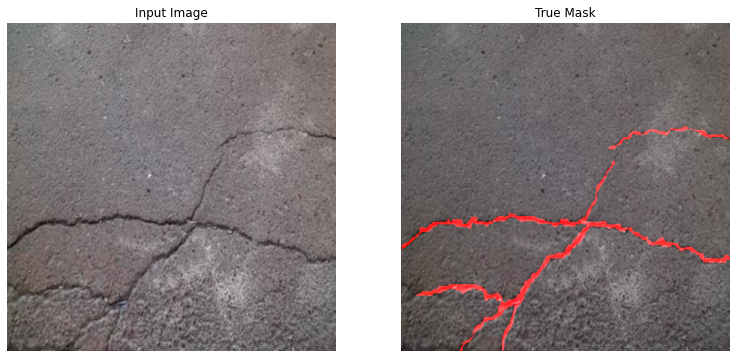

In [ ]:
show_images(read_image("/content/data7/image/CFD_002.jpg"), read_mask("/content/data7/mask/CFD_002.jpg"))

#Метрики

In [ ]:
def iou(y_true, y_pred):
    def f(y_true, y_pred):
        intersection = (y_true * y_pred).sum()
        union = y_true.sum() + y_pred.sum() - intersection
        x = (intersection + 1e-15) / (union + 1e-15)
        x = x.astype(np.float32)
        return x
    return tf.numpy_function(f, [y_true, y_pred], tf.float32)

In [ ]:
def f1(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    recall = true_positives / (possible_positives + K.epsilon())
    f1_val = 2*(precision*recall)/(precision+recall+K.epsilon())
    return f1_val

#UNET

##Создание модели

In [ ]:
def conv_block(input, num_filters):
    x = tf.keras.layers.Conv2D(num_filters, 3, padding="same")(input)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation("relu")(x)

    x = tf.keras.layers.Conv2D(num_filters, 3, padding="same")(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation("relu")(x)
 
    return x

In [ ]:
def encoder_block(input, num_filters):
    x = conv_block(input, num_filters)
    p = tf.keras.layers.MaxPool2D((2, 2))(x)
    return x, p

In [ ]:
def decoder_block(input, skip_features, num_filters):
    x = tf.keras.layers.Conv2DTranspose(num_filters, (2, 2), strides=2, padding="same")(input)
    x = tf.keras.layers.Concatenate()([x, skip_features])
    x = conv_block(x, num_filters)
    return x

In [ ]:
def build_unet(input_shape):
    inputs = tf.keras.layers.Input(input_shape)

    s1, p1 = encoder_block(inputs, 64)
    s2, p2 = encoder_block(p1, 128)
    s3, p3 = encoder_block(p2, 256)
    s4, p4 = encoder_block(p3, 512)

    b1 = conv_block(p4, 1024)

    d1 = decoder_block(b1, s4, 512)
    d2 = decoder_block(d1, s3, 256)
    d3 = decoder_block(d2, s2, 128)
    d4 = decoder_block(d3, s1, 64)

    outputs = tf.keras.layers.Conv2D(1, 1, padding="same", activation="sigmoid")(d4)

    model = tf.keras.models.Model(inputs, outputs, name="UNET")
    return model

##Обучение

Гиперпараметры

In [ ]:
batch = 4
lr = 1e-4
epochs = 10

Cоздание набора данных

In [ ]:
path = "/content/data7/"
(train_x, train_y), (valid_x, valid_y), (test_x, test_y) = load_data(path)

In [ ]:
train_dataset = tf_dataset(train_x, train_y, batch=batch)
valid_dataset = tf_dataset(valid_x, valid_y, batch=batch)
test_dataset = tf_dataset(test_x, test_y, batch=batch)

Callbacks

In [ ]:
class DisplayCallback(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        n=0
        print ('\nSample Prediction after epoch {}\n'.format(epoch+1))
        for image, true_mask in test_dataset.take(5):
            image = np.float32(image[0])
            true_mask = np.uint8(true_mask[0])
            predicted_mask = np.uint8(model.predict(np.expand_dims(image, axis=0))[0]>0.5)
            n+=1
            show_images(image, true_mask, predicted_mask, f"/content/drive/MyDrive/files/UNET/images/Image: {n} Epoch: {epoch+1}.png")

In [ ]:
tensorboard_callback = tf.keras.callbacks.TensorBoard(histogram_freq=1)

Создание модели

In [ ]:
input_shape = (512, 512, 3)
model = build_unet(input_shape)

opt = tf.keras.optimizers.Adam(lr)
metrics = ["acc", tf.keras.metrics.Recall(), tf.keras.metrics.Precision(), iou, f1]
model.compile(loss="binary_crossentropy", optimizer=opt, metrics=metrics)

callbacks = [
    ModelCheckpoint("/content/drive/MyDrive/files/UNET/model.h5"),
    ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=4),
    CSVLogger("/content/drive/MyDrive/files/UNET/data.csv"),
    tensorboard_callback,
    EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=False),
    DisplayCallback()
]

train_steps = len(train_x)//batch
valid_steps = len(valid_x)//batch

if len(train_x) % batch != 0:
        train_steps += 1
if len(valid_x) % batch != 0:
        valid_steps += 1

train_steps = 10
valid_steps = 2

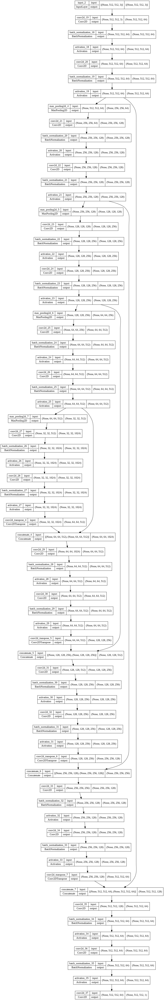

In [ ]:
tf.keras.utils.plot_model(model, show_shapes=True)

In [ ]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

Epoch 1/10
10/10 [==============================] - ETA: 0s - loss: 0.6204 - acc: 0.6910 - recall_1: 0.6023 - precision_1: 0.0568 - iou: 0.0372 - f1: 0.0990
Sample Prediction after epoch 1



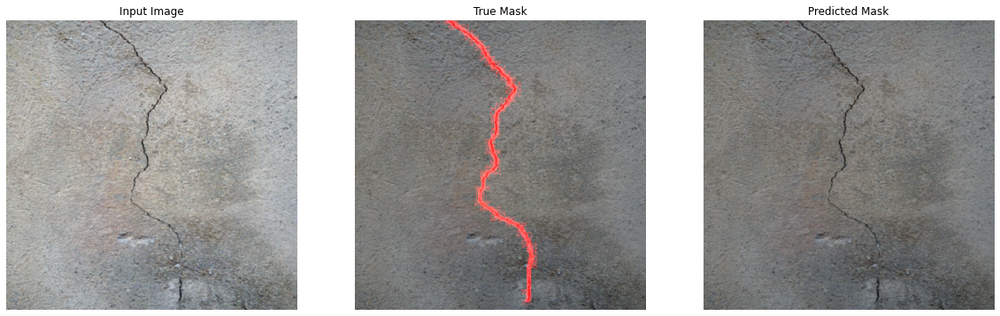

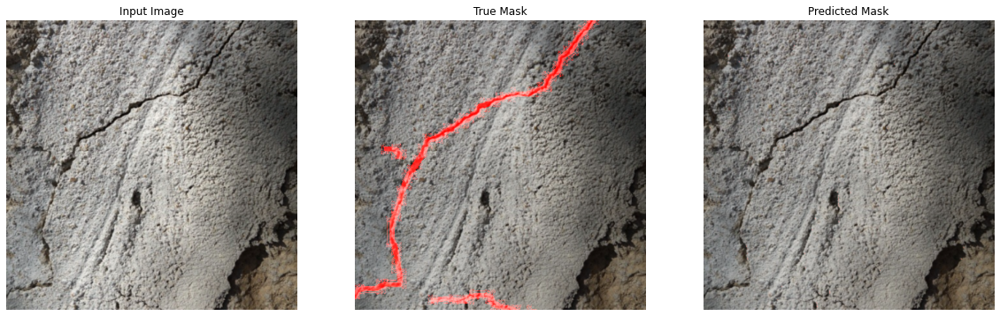

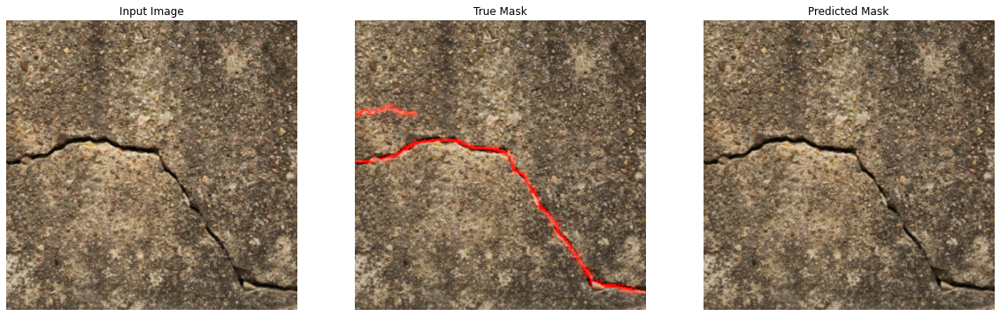

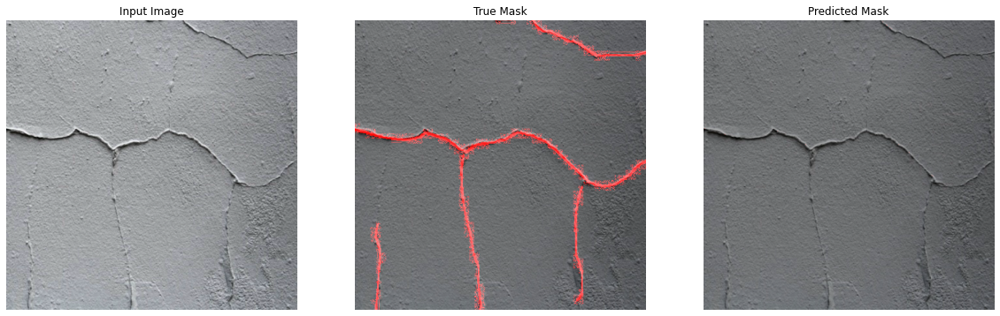

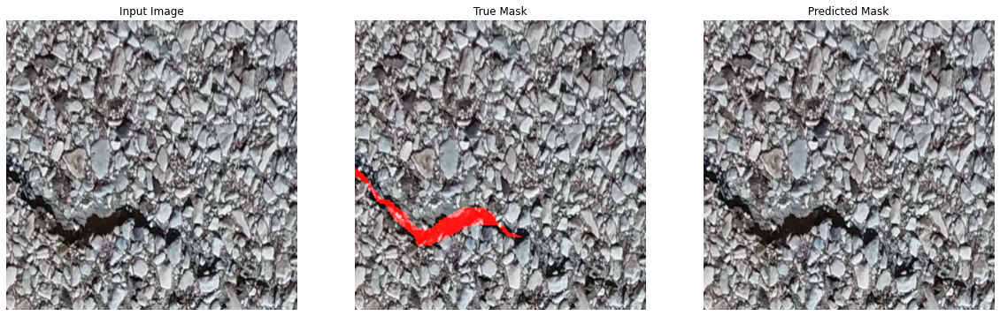

10/10 [==============================] - 53s 5s/step - loss: 0.6204 - acc: 0.6910 - recall_1: 0.6023 - precision_1: 0.0568 - iou: 0.0372 - f1: 0.0990 - val_loss: 0.6779 - val_acc: 0.9775 - val_recall_1: 9.1481e-04 - val_precision_1: 0.0323 - val_iou: 0.0214 - val_f1: 0.0014 - lr: 1.0000e-04
Epoch 2/10
10/10 [==============================] - ETA: 0s - loss: 0.5213 - acc: 0.8392 - recall_1: 0.5658 - precision_1: 0.1273 - iou: 0.0535 - f1: 0.2122
Sample Prediction after epoch 2



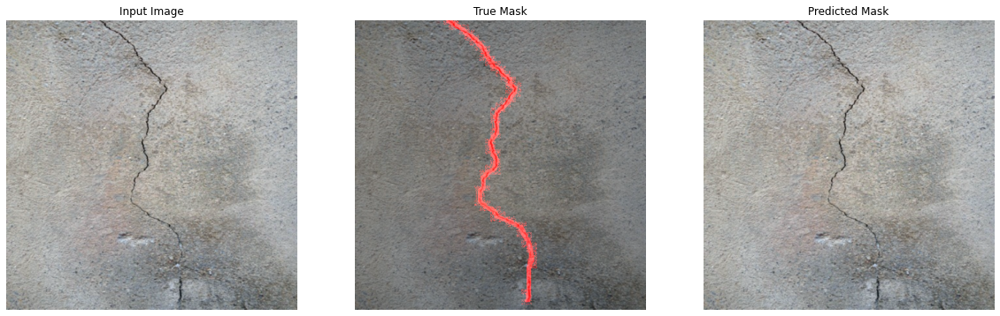

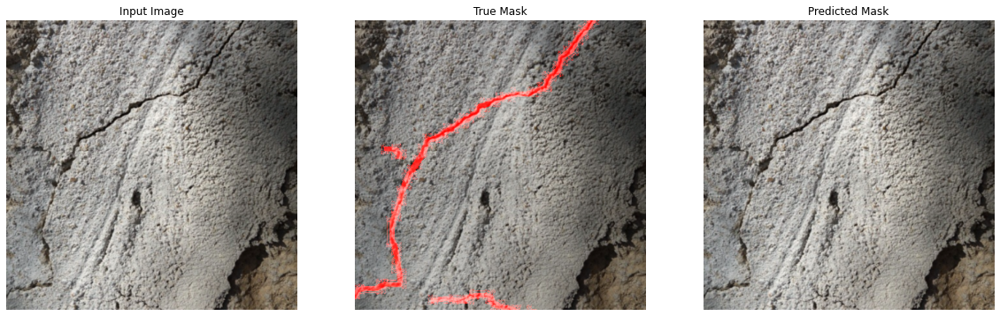

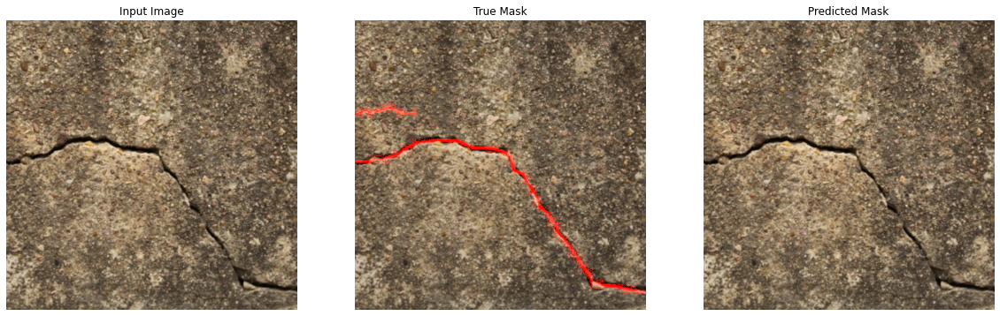

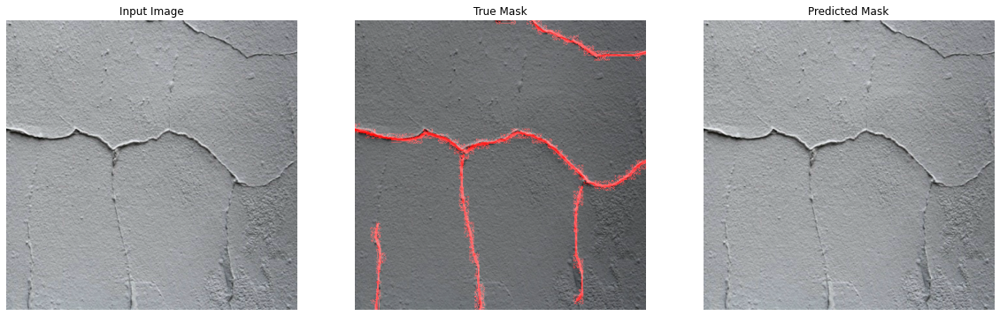

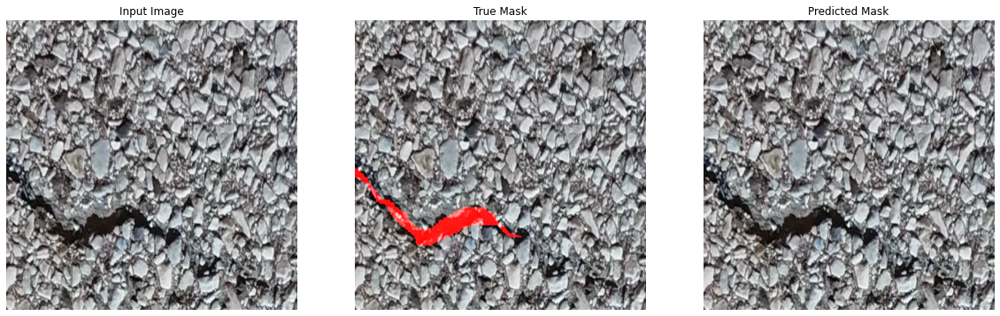

10/10 [==============================] - 50s 5s/step - loss: 0.5213 - acc: 0.8392 - recall_1: 0.5658 - precision_1: 0.1273 - iou: 0.0535 - f1: 0.2122 - val_loss: 0.6609 - val_acc: 0.9781 - val_recall_1: 0.0000e+00 - val_precision_1: 0.0000e+00 - val_iou: 0.0214 - val_f1: 0.0000e+00 - lr: 1.0000e-04
Epoch 3/10
10/10 [==============================] - ETA: 0s - loss: 0.4395 - acc: 0.9301 - recall_1: 0.3756 - precision_1: 0.1815 - iou: 0.0439 - f1: 0.2641
Sample Prediction after epoch 3



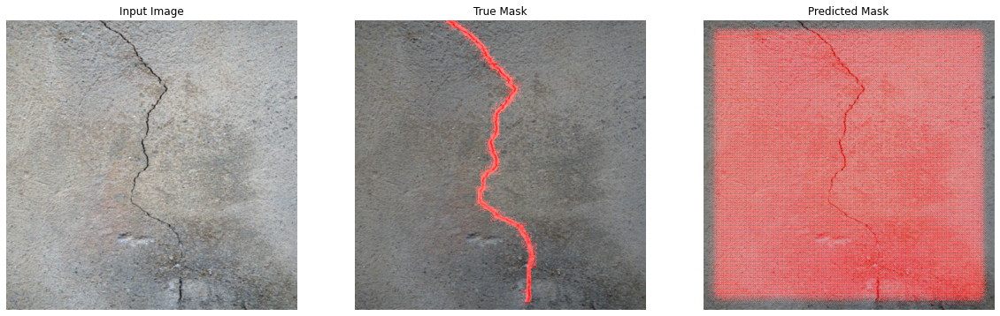

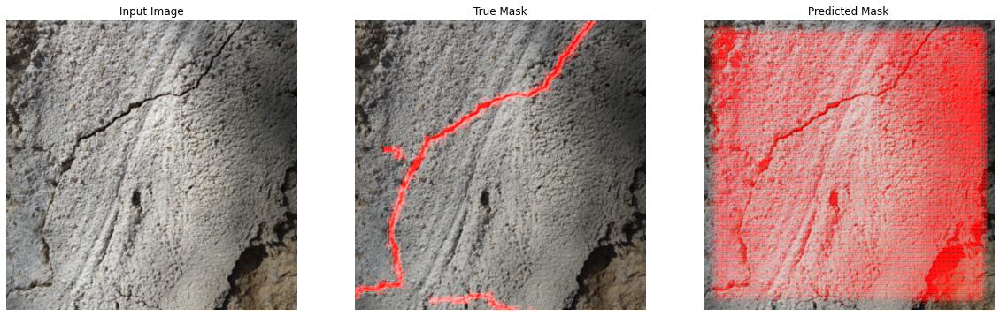

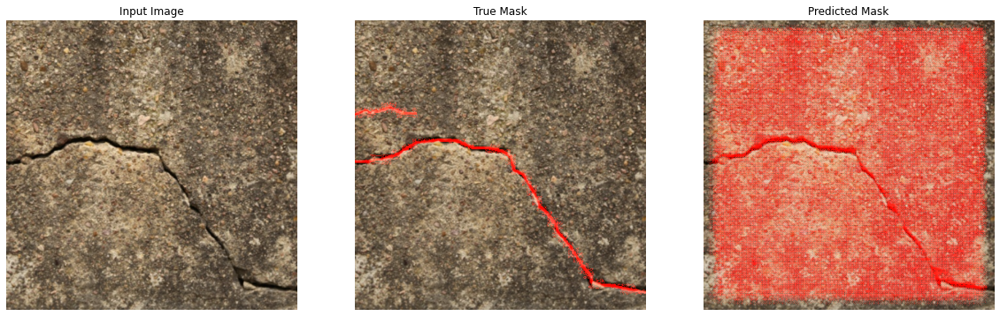

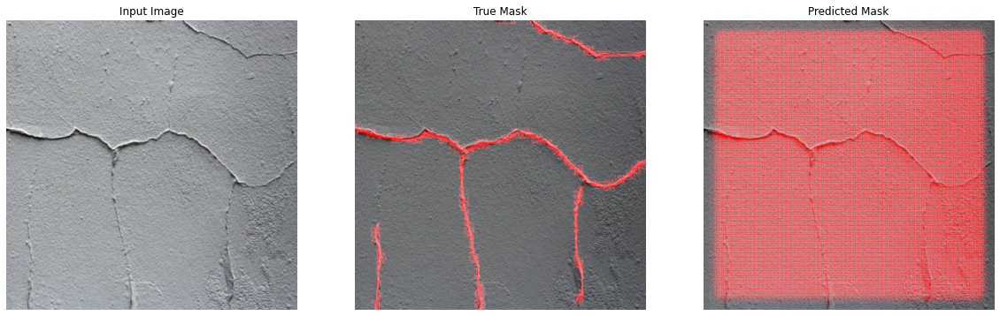

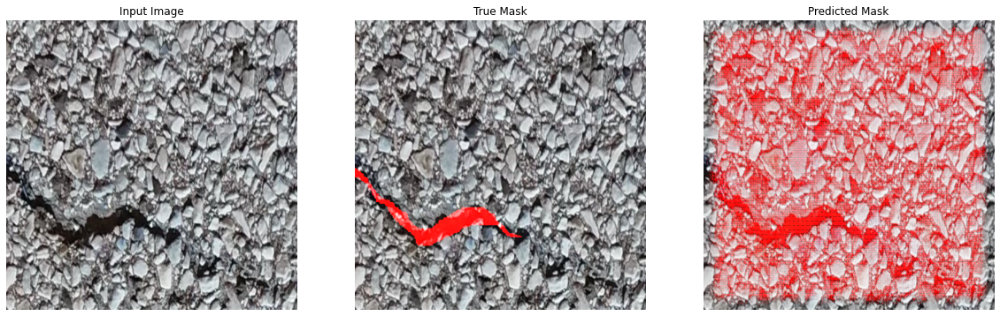

10/10 [==============================] - 52s 5s/step - loss: 0.4395 - acc: 0.9301 - recall_1: 0.3756 - precision_1: 0.1815 - iou: 0.0439 - f1: 0.2641 - val_loss: 0.7005 - val_acc: 0.4060 - val_recall_1: 0.6577 - val_precision_1: 0.0240 - val_iou: 0.0215 - val_f1: 0.0449 - lr: 1.0000e-04
Epoch 4/10
10/10 [==============================] - ETA: 0s - loss: 0.3428 - acc: 0.9559 - recall_1: 0.2919 - precision_1: 0.3170 - iou: 0.0492 - f1: 0.2727
Sample Prediction after epoch 4



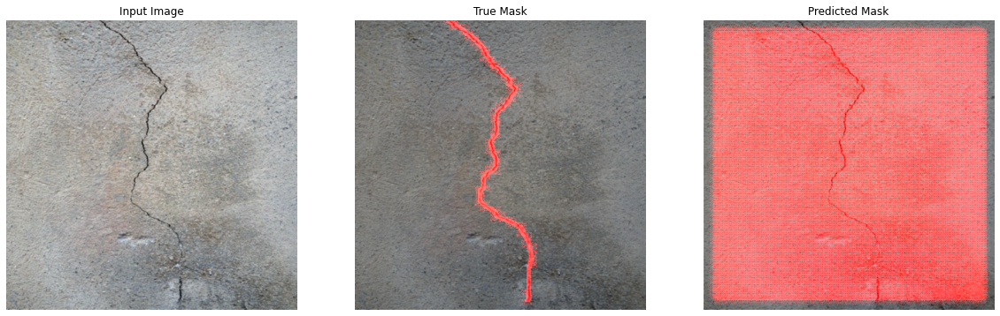

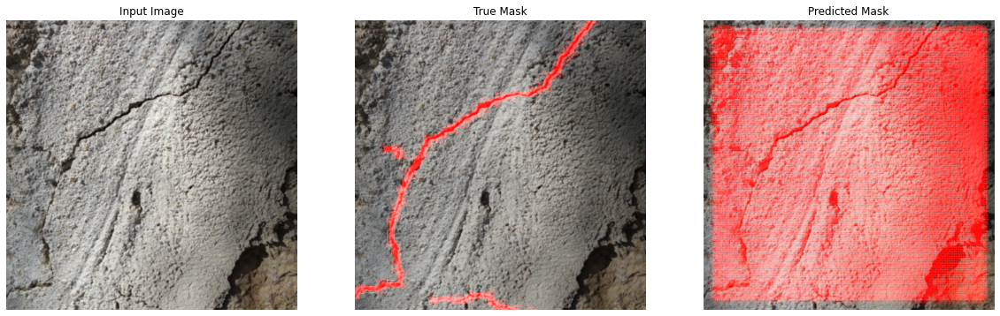

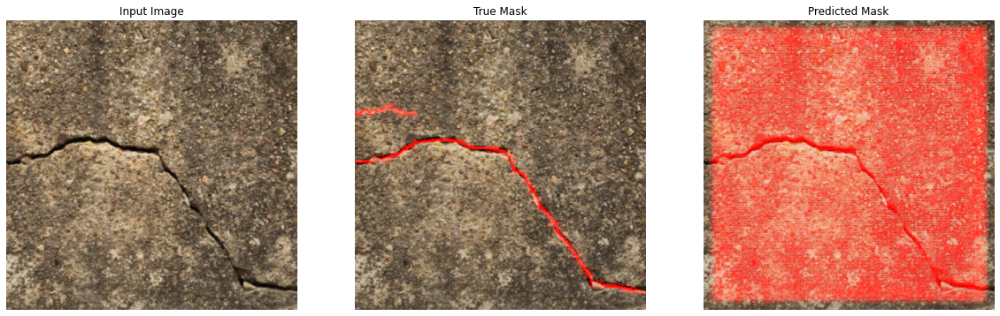

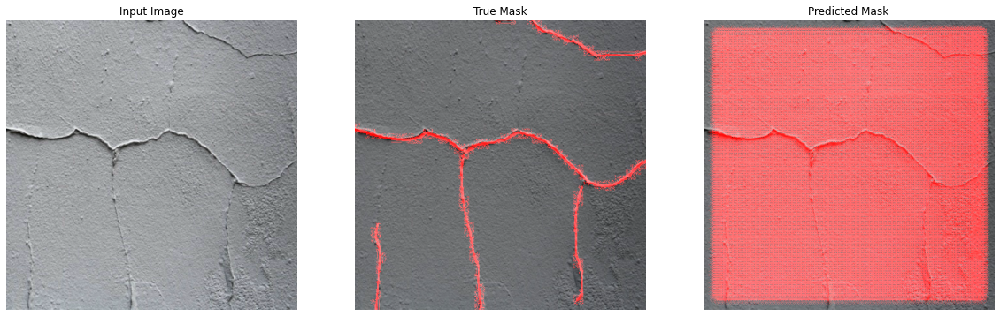

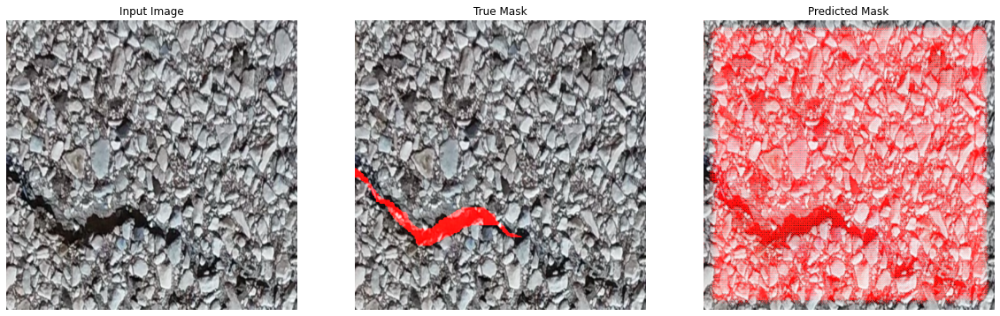

10/10 [==============================] - 51s 5s/step - loss: 0.3428 - acc: 0.9559 - recall_1: 0.2919 - precision_1: 0.3170 - iou: 0.0492 - f1: 0.2727 - val_loss: 0.7453 - val_acc: 0.2255 - val_recall_1: 0.7796 - val_precision_1: 0.0217 - val_iou: 0.0214 - val_f1: 0.0417 - lr: 1.0000e-04
Epoch 5/10
10/10 [==============================] - ETA: 0s - loss: 0.2917 - acc: 0.9566 - recall_1: 0.1662 - precision_1: 0.2560 - iou: 0.0433 - f1: 0.1833
Sample Prediction after epoch 5



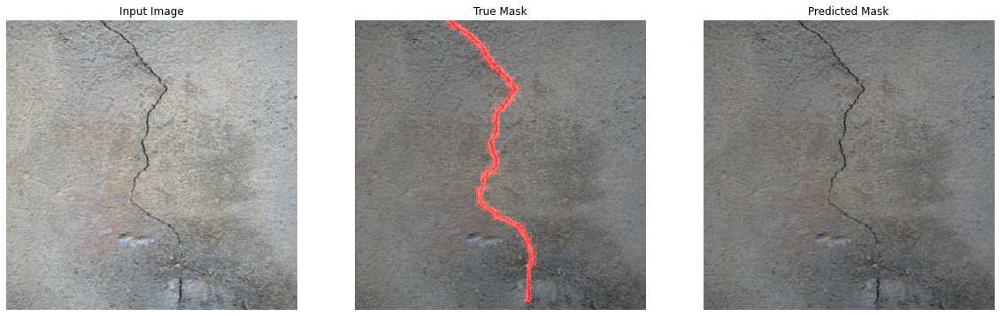

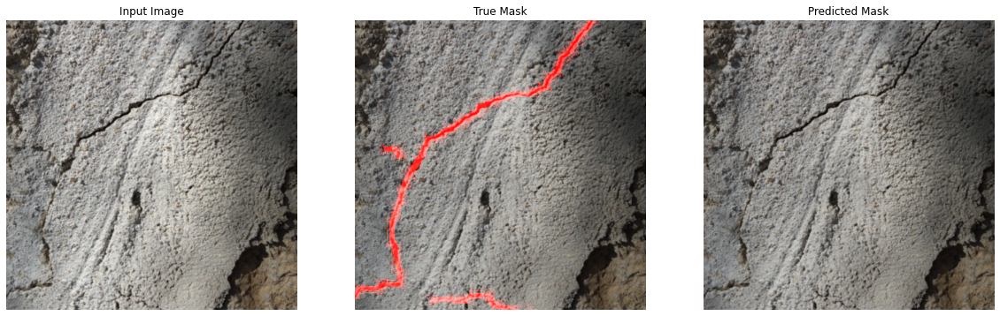

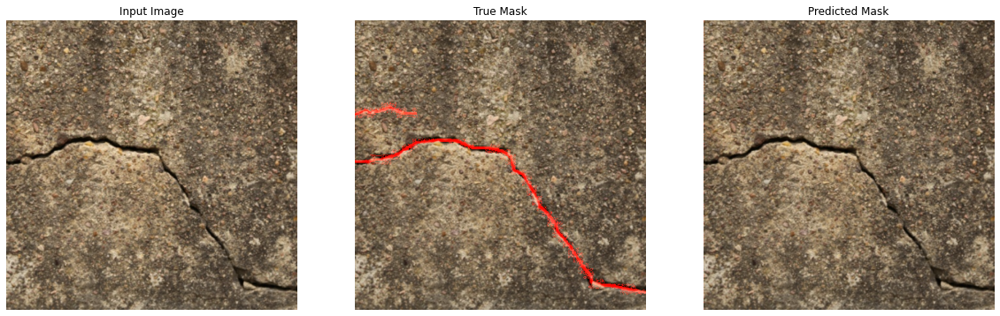

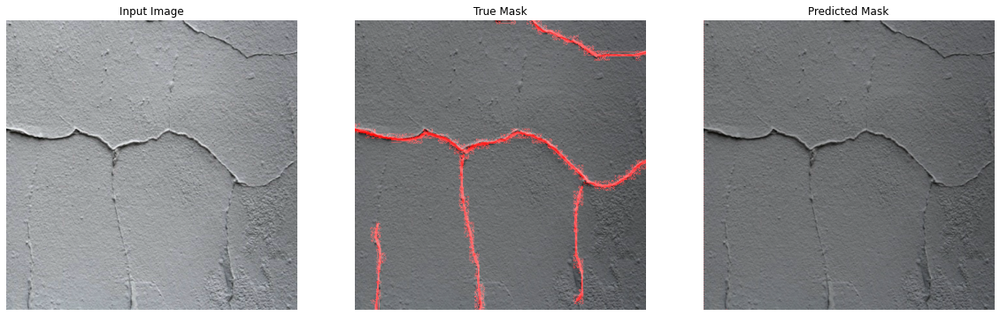

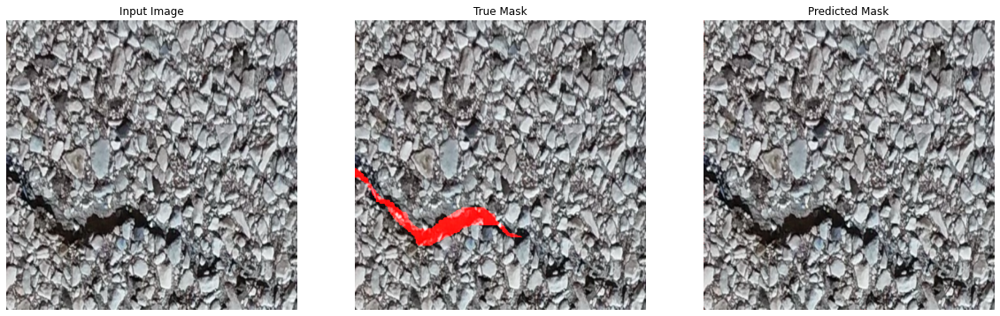

10/10 [==============================] - 52s 5s/step - loss: 0.2917 - acc: 0.9566 - recall_1: 0.1662 - precision_1: 0.2560 - iou: 0.0433 - f1: 0.1833 - val_loss: 0.5500 - val_acc: 0.9779 - val_recall_1: 7.1878e-04 - val_precision_1: 0.0573 - val_iou: 0.0216 - val_f1: 0.0013 - lr: 1.0000e-04
Epoch 6/10
10/10 [==============================] - ETA: 0s - loss: 0.2414 - acc: 0.9682 - recall_1: 0.2564 - precision_1: 0.6619 - iou: 0.0632 - f1: 0.3625

In [ ]:
model.fit(train_dataset,
        validation_data=valid_dataset,
        epochs=epochs,
        steps_per_epoch=train_steps,
        validation_steps=valid_steps,
        callbacks=callbacks)